In [15]:
%pip install leidenalg
%pip install igraph
%pip install pycairo



Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.


In [16]:
%matplotlib inline

In [17]:
import leidenalg as la
import igraph as ig
import pandas as pd
import matplotlib.pyplot as plt
import pickle
from statistics import mean


In [18]:
# edges = pd.read_csv('citationNetworks/Data/edges/edgeList.csv')

# read data in
# MLData = pd.read_csv("citationNetworks/Data/ML/autoScreenedML.csv")
# CTData = pd.read_csv("citationNetworks/Data/CT/autoScreenedCT.csv")
#MLData = pd.DataFrame(MLData)
# MLData.insert(0, 'search', 2)
# CTData.insert(0, 'search', 1)
# MLData.insert(0, 'search', 'ML')
# CTData.insert(0, 'search', 'CT')
# MLData.insert(0, 'label', 'ML')
# CTData.insert(0, 'label', 'CT')
# MLData.insert(0, 'color', 'gold')
# CTData.insert(0, 'color', 'blue')
#MLData['search'] <- '2'
# CTData['search'] <- 1
# MLData['label'] <- "ML"
# CTData['label'] <- "CT"
# MLData['color'] <- "gold"
# CTData['color'] <- "blue"

In [19]:
# fullData = pd.merge(MLData, CTData) 
# fullData
#names(fullData)[names(fullData) == "X"] <- "ID"
#colnames(fullData)
#fullData$ID <- 1:nrow(fullData)
#fullData$search <- as.numeric(fullData$search)
#colnames(edges)
#edges <- edges[c("CitingID", "CitedID")]
#colnames(edges)

In [42]:
# data read in
edges = pd.read_csv('citationNetworks/Data/edges/edgeList.csv')
fullData = pd.read_csv("citationNetworks/Data/dataForPythonModules.csv")

In [43]:
print(edges)
edges = edges.drop(['Unnamed: 0'], axis=1)


       Unnamed: 0  CitingID  CitedID
0               1         4      272
1               2      1430      272
2               3      1558      272
3               4      3020      272
4               5      3906      272
...           ...       ...      ...
37579       37580      4917     2537
37580       37581      5062     2537
37581       37582      5556     4815
37582       37583      5345     5346
37583       37584      5455     6271

[37584 rows x 3 columns]


In [44]:
edges

,CitingID,CitedID
0,4,272
1,1430,272
2,1558,272
3,3020,272
4,3906,272
...,...,...
37579,4917,2537
37580,5062,2537
37581,5556,4815
37582,5345,5346


In [22]:
# tuples = [tuple(x) for x in edges.values]
# g = ig.Graph.TupleList(edges, directed=True)
g = ig.Graph.TupleList(edges.itertuples(index=False), directed=True, weights=False)
print(g)
g1 = g.copy()
g1.simplify()

IGRAPH DN-- 5677 37584 --
+ attr: name (v)
+ edges (vertex names):
   4 -> 272, 5774
 272 ->
1430 -> 272
1558 -> 272, 3450
3020 -> 272, 1250, 3588
3906 -> 272, 3450
5867 -> 272, 1250, 3588
  54 -> 272, 3020, 5867
 145 -> 272, 3020, 5867
1802 -> 272, 1802, 4203, 3253
2060 -> 272, 354, 97, 404, 1181, 2752, 806, 2427, 2898, 5723, 1022, 4251
2210 -> 272, 1558, 3906, 2556, 5251, 5987, 3376, 6300, 3450, 4742, 4320
2720 -> 272, 1558, 3906, 63, 2171, 2171, 2171, 2171, 2171, 2171, 2171, 2171,
2171, 2171, 2171, 2171, 2171, 2171, 2171, 2171, 4251
3192 -> 272, 1430, 2884, 5716, 3356
4203 -> 272, 1802, 4203, 3253
4576 -> 272, 354, 97, 404, 1181, 2752, 806, 2427, 2898, 5723, 1022, 4251
4741 -> 272, 1558, 3906, 2556, 5251, 5987, 3376, 6300, 3450, 4742, 4320
6085 -> 272, 1430, 2884, 5716, 3356
 354 -> 4, 272, 3192, 6085, 2374, 5009, 3190, 6084, 1081, 2884, 5716, 2882,
2171
2374 -> 272, 1558, 3906, 3192, 6085, 2556, 5251, 4658, 1928, 4393, 2170, 4683,
6083, 1081, 3391, 2884, 5716, 3450, 1198, 352, 1047

In [45]:
print(g.ecount())

37584


In [ ]:
print(g1)

In [23]:
# G = ig.Graph.DictList(
#           vertices=fullData.to_dict('records'),
#           edges=edges.to_dict('records'),
#           directed=True,
#           vertex_name_attr='id',
#           edge_foreign_keys=('source', 'target'))

In [24]:
# graph construction 
nodes = fullData["ID"]
# titles = fullData[["ID", "title"]]
# authors = fullData[["ID", "author"]]
# journal =  fullData[["ID", "source_title"]]
# year = fullData[["ID", "year"]]
# search = fullData[["ID", "search"]]
# label = fullData[["ID", "label"]]
# color = fullData[["ID", "color"]]
# references = fullData[["ID", "references"]]

titles = fullData["title"]
authors = fullData["author"]
journal =  fullData["source_title"]
year = fullData["year"]
search = fullData["search"]
label = fullData["label"]
color = fullData["color"]
references = fullData["references"]

In [25]:
g1.vs["ID"] = nodes
# g.vs["title"] = titles
# g.vs["author"] = authors
g1.vs["year"] = year
g1.vs["search"] = search
# g.vs["label"] = label
g1.vs["color"] = color


In [26]:
print(g1)

IGRAPH DN-- 5677 36434 --
+ attr: ID (v), color (v), name (v), search (v), year (v)
+ edges (vertex names):
   4 -> 272, 5774
 272 ->
1430 -> 272
1558 -> 272, 3450
3020 -> 272, 1250, 3588
3906 -> 272, 3450
5867 -> 272, 1250, 3588
  54 -> 272, 3020, 5867
 145 -> 272, 3020, 5867
1802 -> 272, 4203, 3253
2060 -> 272, 354, 97, 404, 1181, 2752, 806, 2427, 2898, 5723, 1022, 4251
2210 -> 272, 1558, 3906, 2556, 5251, 5987, 3376, 6300, 3450, 4742, 4320
2720 -> 272, 1558, 3906, 63, 2171, 4251
3192 -> 272, 1430, 2884, 5716, 3356
4203 -> 272, 1802, 3253
4576 -> 272, 354, 97, 404, 1181, 2752, 806, 2427, 2898, 5723, 1022, 4251
4741 -> 272, 1558, 3906, 2556, 5251, 5987, 3376, 6300, 3450, 4742, 4320
6085 -> 272, 1430, 2884, 5716, 3356
 354 -> 4, 272, 3192, 6085, 2374, 5009, 3190, 6084, 1081, 2884, 5716, 2882,
2171
2374 -> 272, 1558, 3906, 3192, 6085, 2556, 5251, 4658, 1928, 4393, 2170, 4683,
6083, 1081, 3391, 2884, 5716, 3450, 1198, 352, 1047
5009 -> 272, 1558, 3906, 3192, 6085, 2556, 5251, 4658, 1928,

In [27]:
#fig, ax = plt.subplots()
# layout = g.layout_kamada_kawai()
layout = g1.layout_lgl()
# layout = g.layout_fruchterman_reingold()
ig.plot(g1, layout = layout)
# cool looks basically correct 

In [28]:
# calculate modularity
partition = la.find_partition(g1, la.ModularityVertexPartition)
ig.plot(partition)

In [29]:
print(partition)

Clustering with 5677 elements and 96 clusters
[ 0] 4, 272, 1430, 1558, 3906, 2060, 2210, 2720, 3192, 4576, 4741, 6085, 354,
     2374, 5009, 460, 590, 870, 2998, 5843, 1572, 1614, 3971, 2078, 4598,
     2178, 4692, 2274, 2744, 2970, 5800, 2962, 1956, 5790, 2829, 3280, 1848,
     5011, 944, 2813, 5171, 108, 321, 3464, 6372, 1034, 3061, 26, 73, 48, 129,
     580, 634, 1937, 636, 724, 1774, 2173, 4160, 1096, 3227, 1098, 2708, 3216,
     3233, 5458, 6131, 2230, 4771, 2846, 5675, 2706, 2820, 5634, 2870, 5690,
     3452, 2499, 5228, 3468, 52, 3190, 6084, 184, 270, 292, 334, 1702, 2358,
     2564, 3270, 6209, 960, 518, 730, 852, 1469, 1894, 2946, 3124, 6001, 536,
     686, 1559, 2712, 674, 2065, 676, 2063, 728, 2346, 736, 2702, 3068, 1084,
     1162, 3421, 1086, 3193, 1776, 1598, 1772, 2644, 2742, 3000, 3024, 4159,
     5507, 2124, 2226, 4765, 3164, 3194, 6086, 6, 27, 3310, 6242, 3312, 6243,
     1406, 752, 2275, 1524, 3863, 996, 1388, 1972, 2900, 1552, 3900, 3829,
     447, 5611, 5915, 2088,

In [30]:
commMembership = pd.DataFrame({'members':partition})
comNumber = len(commMembership)
commMembership.insert(0, 'community', range(1,comNumber+1))
# commMembership
# type(commMembership.loc[:,'members'])
s = commMembership.apply(lambda x: pd.Series(x['members']), axis=1).stack().reset_index(level=1, drop=True)
s.name = 'ID'
commMembership = commMembership.drop('members', axis=1).join(s)
commMembership = commMembership.astype({'ID' : 'int'})
# commMembership
commMembership.to_csv("citationNetworks/Data/pythonCommunityData.csv")

In [31]:
# type(partition)
# commMembership = list(partition)
# commMembership = pd.wide_to_long(commMembership, stubnames='comID', i='community', j='ID')
#commMembership = partition
# print(commMembership)

#commMembership[1][74] # so is list?
# partition.to_csv
# partition[1]

# commMembership = pd.DataFrame({'members':partition})
# comNumber = len(commMembership)
# commMembership.insert(0, 'community', range(comNumber))
# # commMembership
# s = commMembership.apply(lambda x: pd.Series(x['members']), axis=1).stack().reset_index(level=1, drop=True)
# s.name = 'ID'
# commMembership.drop('members', axis=1).join(s)
# commMembership
# rows = []
# _ = commMembership.apply(lambda row: [rows.append([row['community'], ID]) for ID in row.members], axis=1)
# df_new = pd.DataFrame(rows, columns=commMembership.columns).set_index(['community', 'ID'])
# commMembership.to_csv("citationNetworks/Data/pythonCommunityData.csv")



In [32]:
# (pd.melt(commMembership.members.apply(pd.Series).reset_index(),
#              id_vars=['community', 'members'],
#              value_name='members')
#      .set_index(['community', 'members'])
#      .drop('variable', axis=1)
#      .dropna()
#      .sort_index()
#      )

In [33]:
#help(g.rewire)

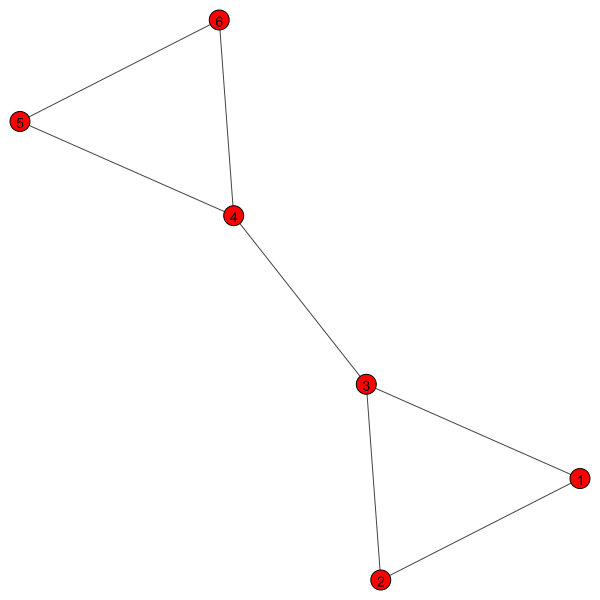

In [34]:
# do the rewiring? 

# do a little 10 item demo 
gDemo = ig.Graph()
gDemo.add_vertices(3)
gDemo.add_edges([(0,1), (1,2)])
gDemo.add_edges([(2, 0)])
gDemo.add_vertices(3)
gDemo.add_edges([(2, 3), (3, 4), (4, 5), (5, 3)])
labels = ['1', '2', '3', '4', '5', '6']
gDemo.vs['label'] = labels
ig.plot(gDemo)
# need to label nodes to check that degree is retained 

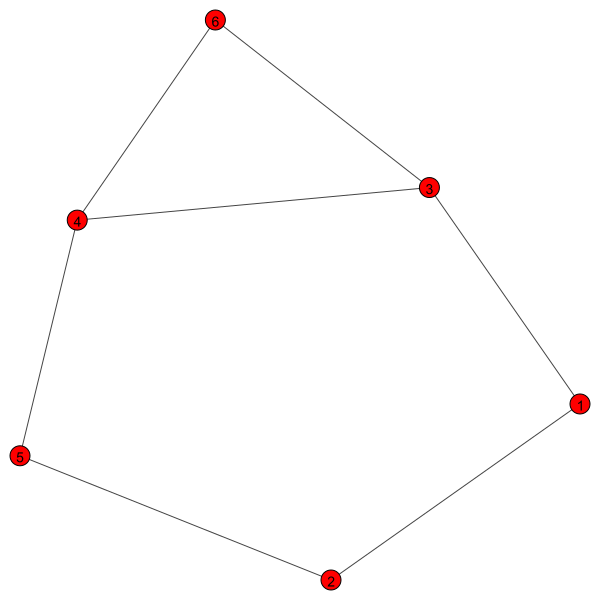

In [35]:
gDemo.rewire(n=gDemo.vcount()*10)
ig.plot(gDemo)

In [36]:
g2 = g1.copy()
originalModularity = g1.modularity(partition)
print(originalModularity)



0.5448366987471621


In [37]:
print(g1.ecount())

36434


In [38]:
print(g1.vcount())

5677


(array([   9.,   75.,  308., 1044., 2277., 2902., 2181.,  948.,  224.,
          32.]),
 array([0.23663279, 0.23757386, 0.23851494, 0.23945601, 0.24039709,
        0.24133816, 0.24227923, 0.24322031, 0.24416138, 0.24510246,
        0.24604353]),
 <BarContainer object of 10 artists>)

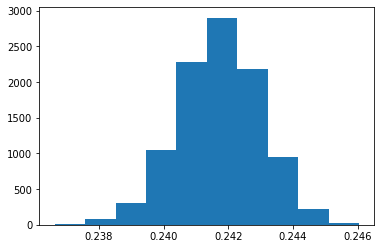

In [22]:
# g2 = g1.copy()
# originalModularity = g1.modularity(partition)
# print(originalModularity)

# g2.rewire(n=g2.vcount()*10)

modularityList = list()
for i in range(10000):
    g2.rewire(n=g2.vcount()*10)
    partition = la.find_partition(g2, la.ModularityVertexPartition)
    # membership = partition.membership() # need to work out what partition actually is 
    modularity = g2.modularity(partition)
    modularityList.append(modularity)
plt.hist(modularityList)





# modularityList <- c()
# for (i in 1:10) { # 10000
#         # graph <- sample_gnm(6372, 37584, directed = FALSE, loops = FALSE) # where is degree in there? 
#         # needs to maintain both in- and out-degree
#         # igraph_rewire() ???
#         # degree.distribution()
#         # graph should be directed!!!
#         graph <- rewire(net, with = keeping_degseq(niter = vcount(net) * 10))
#         # graphCluster <- cluster_louvain(graph)
#         # graphCluster <- edge.betweenness(graph)
#         graphCluster <- edge.betweenness.community(graph)
#         graphMembers <- igraph::membership(graphCluster)
#         graphModularity <- modularity(graph, graphMembers)
#         modularityList <- append(modularityList, graphModularity)
# }

In [16]:
print(mean(modularityList))

0.24173851941230096


In [27]:
with open('modularityOutfile', 'wb') as fp:
    pickle.dump(modularityList, fp)


In [3]:
with open ('modularityOutfile', 'rb') as fp:
    modularityList = pickle.load(fp)

In [4]:
# %matplotlib inline
# import matplotlib.pyplot as plt
# import matplotlib

# plt.figure(figsize=(12,12))
# plt.xlabel('Modularity')
# plt.ylabel('Frequency')
# txt = 'Figure 1. Histogram of modularity of ten thousand degree maintained graphs. \n Each graph has 5677 nodes and 36434 edges. Mean modularity is 0.242 (rounded to 3 significant figures).'
# plt.figtext(.5, 0, txt, wrap=True, ha='center', size='large', stretch='expanded') # va='center'


# font = {'family' : 'normal',
#         'weight' : 'bold',
#         'size'   : 22}

# matplotlib.rc('font', **font)

# plt.hist(modularityList)




# plt.savefig('citationNetworks\Graphics\modularityHist.png')

#ax1 = fig.add_axes((0.1,0.4,0.8,0.5))
#ax1.set_xlabel(r'\begin{center}X-axis\\*\textit{\small{' + txt + r'}}\end{center}')


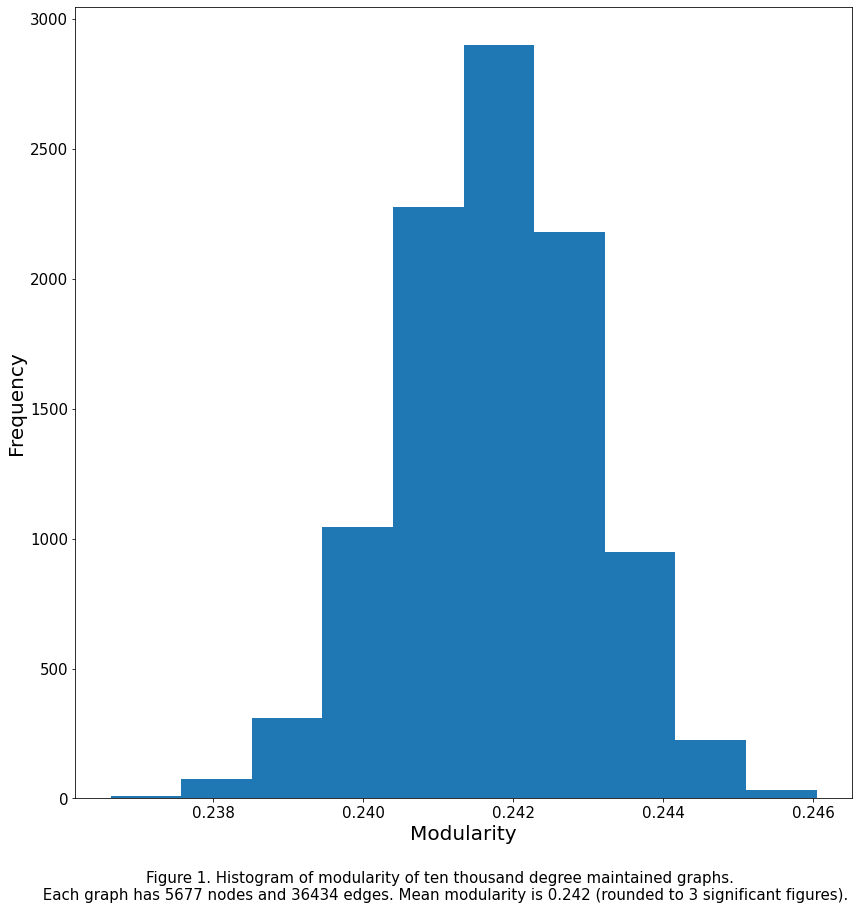

In [13]:
%matplotlib inline
import matplotlib.pyplot as plt
# import matplotlib

plt.figure(figsize=(12,12))
plt.xlabel('Modularity')
plt.ylabel('Frequency')
txt = 'Figure 1. Histogram of modularity of ten thousand degree maintained graphs. \n Each graph has 5677 nodes and 36434 edges. Mean modularity is 0.242 (rounded to 3 significant figures).'
plt.figtext(.5, -0.05, txt, wrap=True, ha='center', size=15, stretch='expanded') # va='center'


plt.rc('axes', labelsize=20) 
plt.rc('xtick', labelsize=15)
plt.rc('ytick', labelsize=15)
plt.tight_layout()
plt.hist(modularityList)




plt.savefig('citationNetworks\Graphics\modularityHist.png', bbox_inches="tight")